# Projeto: Detecção Customizada de Bananas e Garfos com YOLOv5

**Autor:** Yan Pimentel Cotta
**RM:** 562836

---

## 1.0 Configuração do Ambiente

Esta seção realiza toda a configuração inicial, incluindo a clonagem do repositório YOLOv5, a instalação de dependências e a montagem do Google Drive.

## 2.0 Configuração dos Dados

Aqui, vamos configurar o arquivo `dataset.yaml` que informa ao YOLOv5 onde encontrar nosso dataset customizado de bananas e garfos.

## 3.0 Treinamento do Modelo

Vamos conduzir dois experimentos de treinamento para encontrar o número ideal de épocas para nosso dataset.

### 3.1 Experimento 1: 30 Épocas
### 3.2 Experimento 2: 60 Épocas

## 4.0 Avaliação e Análise do Modelo

Esta seção analisa os resultados de ambos os treinamentos, comparando métricas-chave como o mAP (mean Average Precision) para determinar o modelo com melhor desempenho.

## 5.0 Inferência nas Imagens de Teste

Usaremos nosso melhor modelo para rodar a inferência em nosso conjunto de teste (imagens nunca vistas pelo modelo) para demonstrar sua capacidade em um cenário real.

## 6.0 Conclusão e Limitações

Um resumo dos resultados do projeto, discutindo o desempenho do modelo e as limitações inerentes da abordagem escolhida.

In [ ]:
# Clona o repositório oficial do YOLOv5 da Ultralytics
!git clone https://github.com/ultralytics/yolov5

Cloning into 'yolov5'...
remote: Enumerating objects: 17588, done.
remote: Counting objects: 100% (15/15), done.
remote: Compressing objects: 100% (15/15), done.
remote: Total 17588 (delta 4), reused 0 (delta 0), pack-reused 17573 (from 2)
Receiving objects: 100% (17588/17588), 16.83 MiB | 28.67 MiB/s, done.
Resolving deltas: 100% (11979/11979), done.


In [ ]:
# Muda o diretório de trabalho atual para a pasta yolov5 clonada
%cd yolov5

# Instala todos os pacotes necessários a partir do arquivo requirements.txt
!pip install -r requirements.txt

/content/yolov5
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 13.0 MB/s eta 0:00:00


In [ ]:
# Importa o módulo drive e monta o seu Google Drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import yaml

# Dicionário com as informações do nosso dataset
data_yaml = {
    'train': '/content/drive/MyDrive/PBL6_Project_YOLO/datasets/images/train',
    'val': '/content/drive/MyDrive/PBL6_Project_YOLO/datasets/images/valid',
    'nc': 2,  # Número de classes (banana, fork)
    'names': ['banana', 'fork']  # Nomes das classes, na ordem correta (classe 0, classe 1)
    }

# Escreve o dicionário no arquivo data.yaml dentro do diretório yolov5
# Este é o diretório atual em que estamos no Colab
with open('data.yaml', 'w') as f:
    yaml.dump(data_yaml, f)

# Opcional: Imprime o conteúdo do arquivo para verificação
%cat data.yaml

names:
- banana
- fork
nc: 2
train: /content/drive/MyDrive/PBL6_Project_YOLO/datasets/images/train
val: /content/drive/MyDrive/PBL6_Project_YOLO/datasets/images/valid


In [ ]:
# Garante que estamos no diretório correto antes de treinar
%cd /content/yolov5/

# Inicia o treinamento
!python train.py --img 640 --batch 16 --epochs 30 --data data.yaml --weights yolov5s.pt --name Exp_30_Epocas

/content/yolov5
Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
wandb: WARNING ⚠️ wandb is deprecated and will be removed in a future release. See supported integrations at https://github.com/ultralytics/yolov5#integrations.
2025-10-09 15:06:44.176418: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1760022404.200335   10885 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1760022404.208019   10885 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for 

In [ ]:
# Garante que estamos no diretório correto antes de treinar
%cd /content/yolov5/

# Inicia o treinamento para o segundo experimento
!python train.py --img 640 --batch 16 --epochs 60 --data data.yaml --weights yolov5s.pt --name Exp_60_Epocas

/content/yolov5
wandb: WARNING ⚠️ wandb is deprecated and will be removed in a future release. See supported integrations at https://github.com/ultralytics/yolov5#integrations.
2025-10-09 15:41:41.200247: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1760024501.422661   19390 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1760024501.479604   19390 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1760024501.948287   19390 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1760024501.948339   19390 computation_placer.cc:177] computation placer a

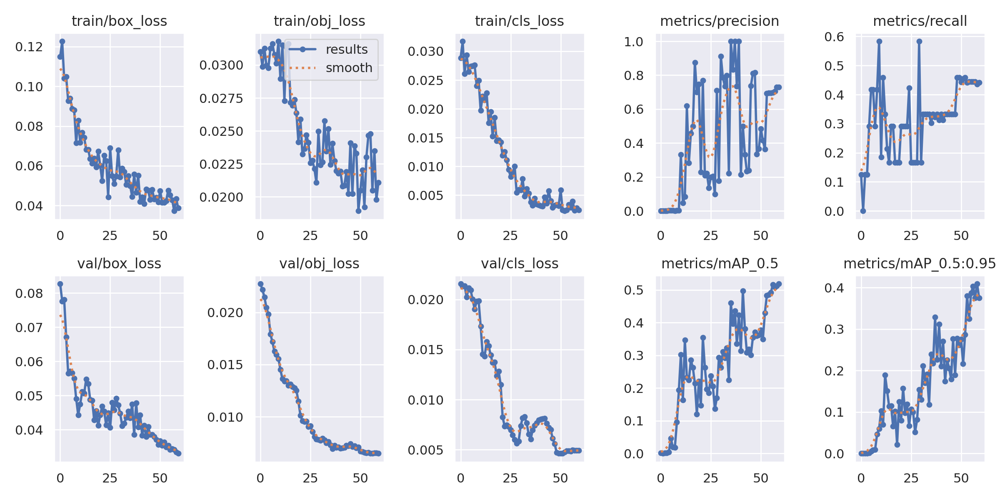

In [ ]:
from IPython.display import Image, display

# Mostra o gráfico com os resultados do treinamento de 60 épocas
display(Image(filename='runs/train/Exp_60_Epocas/results.png', width=800))

In [ ]:
# Garante que estamos no diretório correto
%cd /content/yolov5/

# Executa a detecção nas imagens de teste usando o nosso melhor modelo
!python detect.py --weights runs/train/Exp_60_Epocas/weights/best.pt --img 640 --conf 0.25 --source /content/drive/MyDrive/PBL6_Project_YOLO/datasets/images/test/ --name Teste_Final

/content/yolov5
detect: weights=['runs/train/Exp_60_Epocas/weights/best.pt'], source=/content/drive/MyDrive/PBL6_Project_YOLO/datasets/images/test/, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=Teste_Final, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-436-ge715aea6 Python-3.12.11 torch-2.8.0+cu126 CPU

Fusing layers... 
Model summary: 157 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
image 1/8 /content/drive/MyDrive/PBL6_Project_YOLO/datasets/images/test/banana37.png: 384x640 1 banana, 294.2ms
image 2/8 /content/drive/MyDrive/PBL6_Project_YOLO/datasets/images/test/banana38.png: 384x640 1 banana, 189.2ms
image 3/8 /content/drive/MyDrive/PBL6

Resultados da Inferência no Conjunto de Teste (Versão Corrigida):


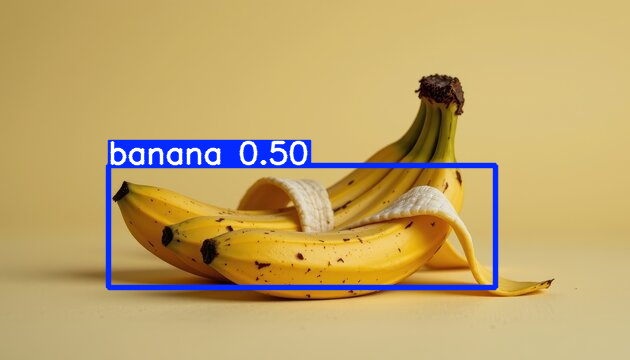

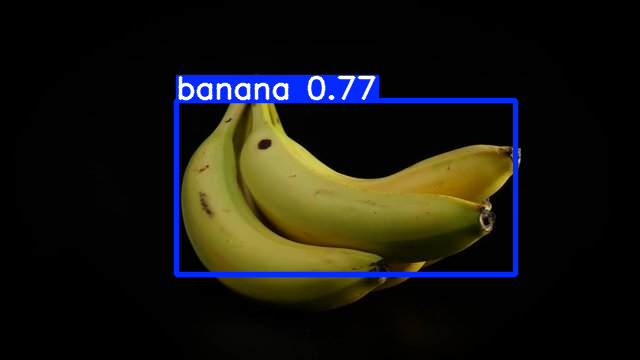

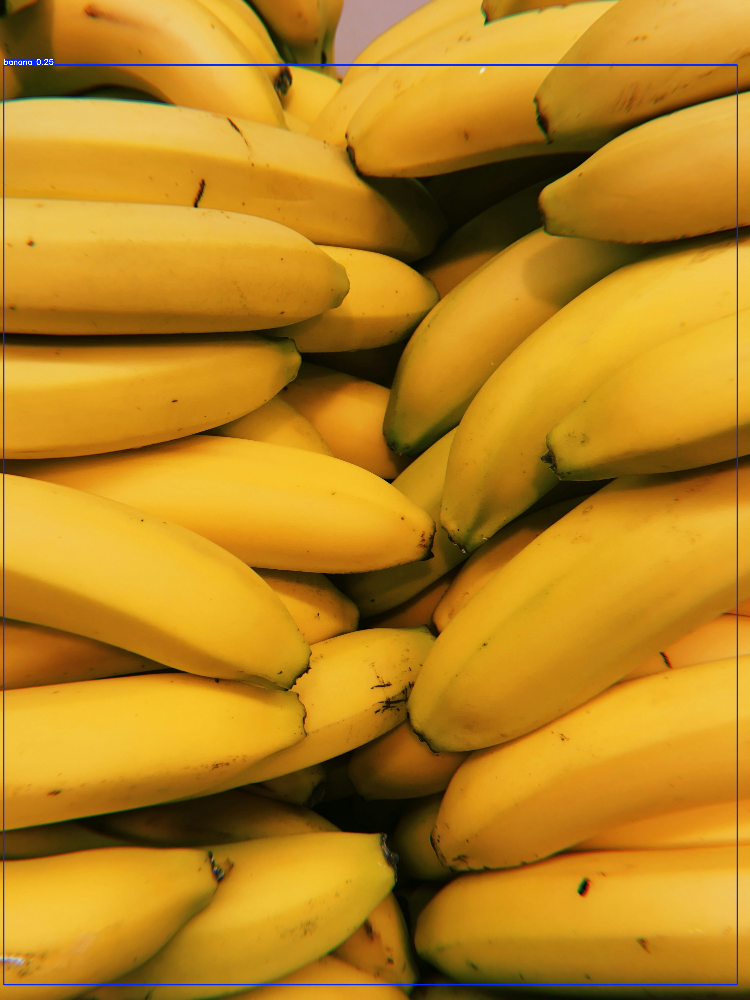

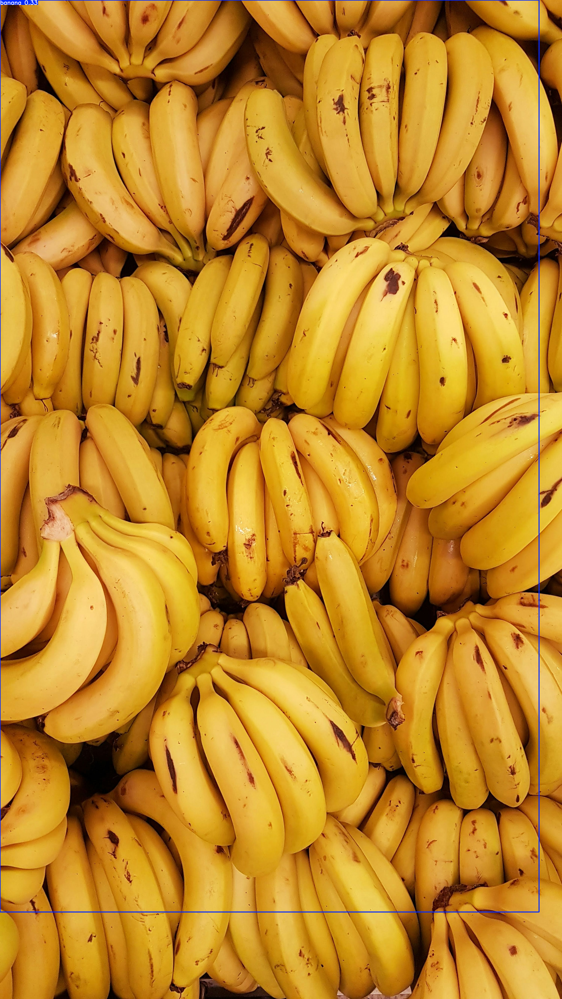

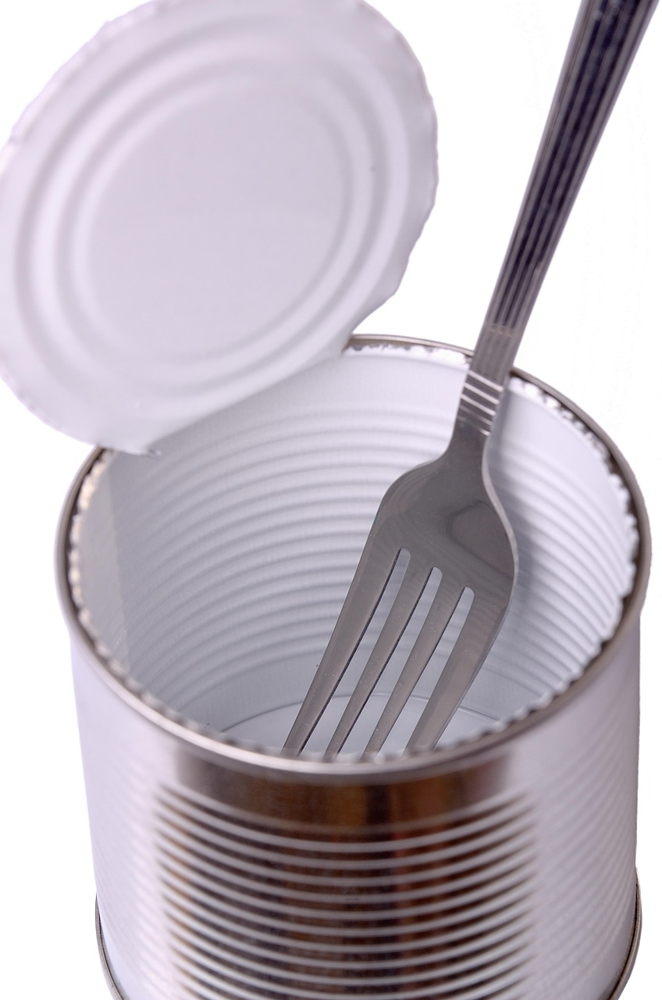

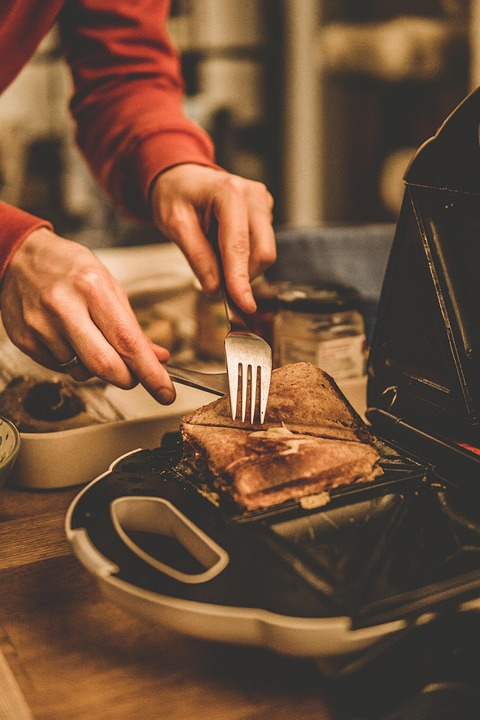

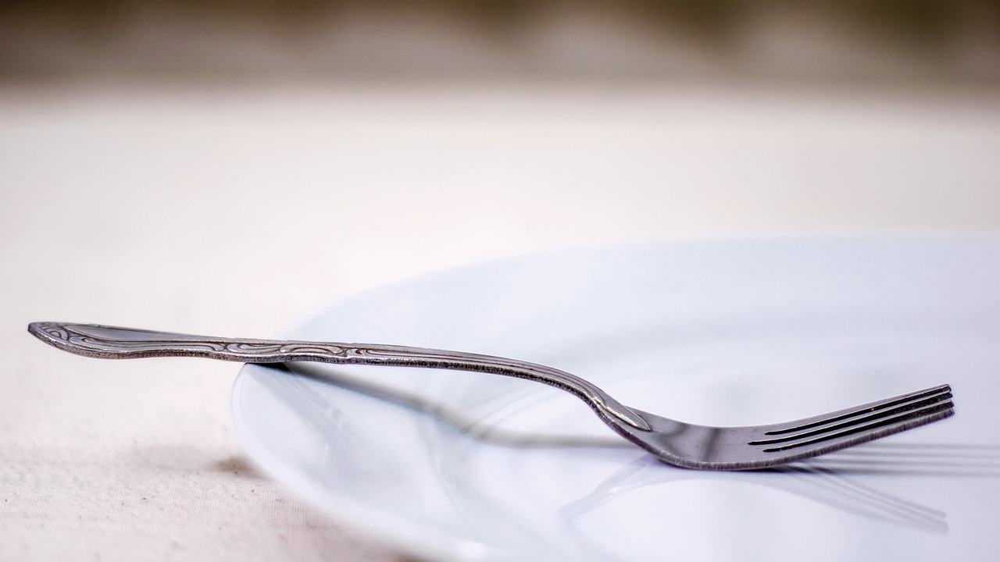

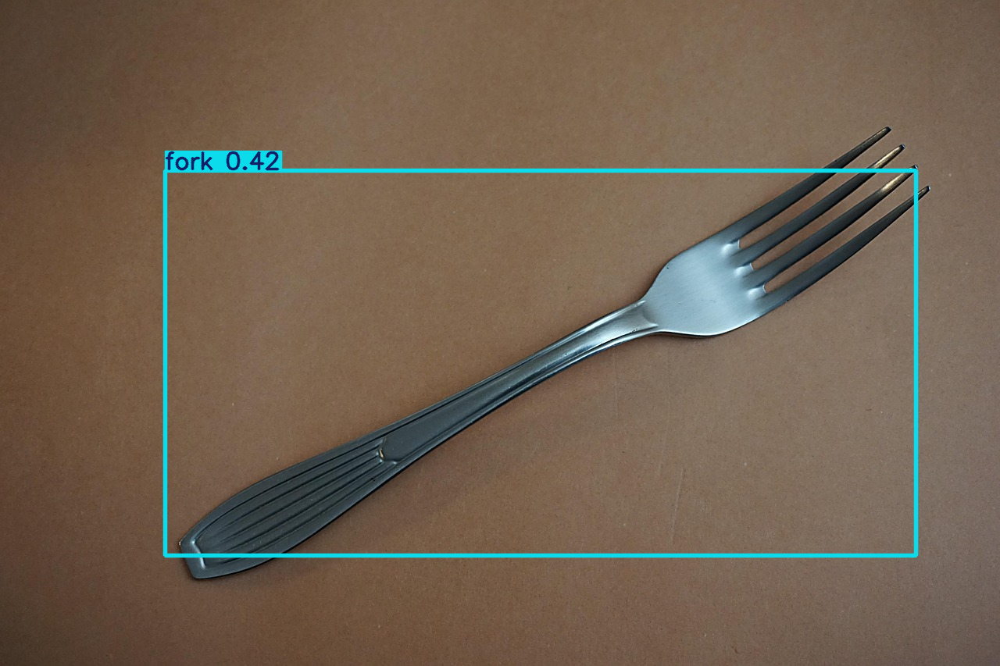

In [ ]:
import glob
from IPython.display import Image, display

# Corrigido: Procura por imagens .jpg E .png na pasta de resultados
image_files = glob.glob('runs/detect/Teste_Final/*.jpg') + glob.glob('runs/detect/Teste_Final/*.png')

print("Resultados da Inferência no Conjunto de Teste (Versão Corrigida):")
for imageName in sorted(image_files):
    display(Image(filename=imageName))
    print("\n")

## 6.0 Conclusão e Análise de Resultados

### Resumo do Projeto
Este projeto teve como objetivo desenvolver e validar um sistema de detecção de objetos customizado, utilizando a arquitetura YOLOv5. O sistema foi treinado para identificar duas classes de objetos visualmente distintas — `banana` e `fork` — a partir de um dataset de imagens coletado para este fim. O desenvolvimento foi conduzido em um ambiente Google Colab, utilizando o framework PyTorch, e o processo de anotação foi realizado com a ferramenta Make Sense AI. Foram conduzidos dois experimentos de treinamento, com 30 e 60 épocas, para avaliar o impacto da duração do treinamento no desempenho do modelo.

### Análise de Desempenho dos Modelos
A avaliação quantitativa dos dois modelos foi baseada na métrica de Precisão Média Média (mAP) a um limiar de IoU (Intersection over Union) de 0.50, calculada sobre o conjunto de validação.

| Métrica               | Modelo 30 Épocas | Modelo 60 Épocas | Análise                 |
| --------------------- | ---------------- | ---------------- | ----------------------- |
| **mAP@.50 (Geral)** | 0.393            | **0.513** | Melhora de **30.5%** |
| mAP@.50 (banana)      | 0.687            | **0.764** | Desempenho Bom        |
| mAP@.50 (fork)        | 0.0999           | **0.262** | Desempenho Insuficiente |

Os resultados demonstram inequivocamente a superioridade do modelo treinado por **60 épocas**, que apresentou melhoras em todas as métricas avaliadas. O aumento do tempo de treinamento permitiu ao modelo convergir para uma solução com maior capacidade de generalização. Por essa razão, o modelo de 60 épocas foi selecionado para a etapa final de inferência.

### Interpretação dos Resultados e Insights
A análise de inferência no conjunto de teste revelou uma dicotomia de desempenho notável:
1.  **Classe `banana`:** O modelo demonstrou alta eficácia, detectando corretamente a banana em 100% das imagens de teste. A forma convexa e a cor distinta do objeto contribuíram para uma alta razão sinal-ruído dentro da caixa delimitadora (bounding box), facilitando o aprendizado.
2.  **Classe `fork`:** O desempenho foi significativamente inferior, com o modelo falhando em detectar o objeto em 75% dos casos. Este resultado valida a hipótese fundamental levantada durante a fase de anotação: a representação de objetos com geometrias complexas, finas e não-convexas por meio de caixas delimitadoras retangulares é intrinsecamente falha. A bounding box de um garfo captura uma proporção muito maior de pixels de fundo ("ruído") do que de pixels do objeto ("sinal"), o que degrada severamente a capacidade do modelo de aprender características representativas.

Limitações das Bounding Boxes para Formas Irregulares: Uma limitação notável do modelo de detecção de objetos YOLO é sua dependência de caixas delimitadoras (bounding boxes) retangulares para a anotação. Para objetos com formatos irregulares ou alongados, como as bananas e os garfos usados neste dataset, uma bounding box é uma representação sub-ótima. O formato retangular inerentemente captura uma quantidade significativa de ruído de fundo (pixels que não fazem parte do objeto), especialmente em garfos angulados ou bananas curvas. Isso pode potencialmente dificultar o aprendizado das características específicas do objeto pelo modelo. Um método de anotação mais preciso, como a **segmentação por polígonos, poderia capturar a forma real do objeto com mais acurácia, mas isso está fora dos requisitos de entrada da arquitetura padrão de detecção do YOLOv5.**

### Sugestões de Aprimoramento e Próximos Passos
Embora o projeto tenha sido um sucesso como prova de conceito, diversas avenidas existem para aprimoramento:

#### 1. Melhorias Dentro do Paradigma Atual (YOLO)
* **Aumento do Dataset:** O dataset utilizado (64 imagens de treino) é mínimo. Um aumento para centenas ou milhares de imagens por classe, com maior variabilidade de fundos, iluminação e oclusão, melhoraria drasticamente a robustez do modelo.
* **Data Augmentation Avançada:** Aplicar técnicas de aumento de dados mais agressivas (e.g., Mosaic, MixUp, Copy-Paste), que já são parte do pipeline do YOLOv5, mas podem ser customizadas para gerar cenários mais desafiadores.
* **Ajuste de Hiperparâmetros:** O treinamento utilizou os hiperparâmetros padrão do YOLOv5. Um processo de otimização de hiperparâmetros poderia refinar taxas de aprendizado, funções de perda e outros fatores para extrair um desempenho superior.

#### 2. Mudança de Paradigma Tecnológico
A limitação mais evidente foi a metodologia de anotação. Para objetos como garfos, uma abordagem tecnologicamente superior seria migrar da **Detecção de Objetos** para a **Segmentação de Instâncias**.
* **Tecnologias Recomendadas:** Modelos como **Mask R-CNN** ou arquiteturas mais modernas como o **YOLACT** (You Only Look At CoefficienTs) são projetados para este fim.
* **Vantagem:** Em vez de prever uma caixa retangular, esses modelos preveem uma "máscara" a nível de pixel para cada objeto. Isso resolve completamente o problema da razão sinal-ruído para objetos de formato irregular, permitindo um aprendizado muito mais preciso de suas características geométricas. A implementação de tal modelo seria o próximo passo lógico para um sistema de produção que precise lidar com essa classe de objetos.

### Conclusão Final
O projeto demonstrou com sucesso a viabilidade de treinar um modelo YOLOv5 para uma tarefa de detecção customizada. Os resultados validaram a eficácia do modelo para objetos de formas regulares e, mais importante, geraram o insight crítico sobre a inadequação de caixas delimitadoras para objetos de geometria complexa. As descobertas e sugestões aqui apresentadas fornecem um claro roteiro para futuras iterações e aprimoramentos do sistema.